<a href="https://colab.research.google.com/github/GiX7000/deep-learning-with-tensorflow/blob/main/deep_learning_with_tensorflow_Part7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Deep Learning with TensorFlow with Laurence Moroney, Part7

We can divide object recognition down to a two stage process. The first is to propose a region, be it a sliding window or something else. The second then identifies a classifies the object within that region. You'll see this pattern in many of the common architectures that are used by object detection, models.

Remember that one way to evaluate how close the predicted bounding box is to the true label Is called intersection over union. If we pick the sliding window that has the highest intersection of A union, we can choose that to be the bounding box and ignore the other sliding windows. This technique of selecting the best bounding box based on the highest IOU is called non maximum suppression. You can think of non maximum suppression as suppressing or ignoring the sliding windows that don't have the maximum IOU and keeping just the window with the maximum IOU, non maximum suppression can be used during training to optimize and tweak the sliding windows that you use as the bounding box.

## Example 1. Simple Object Detection in Tensorflow(Inference only).

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
from PIL import Image
from PIL import ImageOps
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

In [ ]:
# Download the model from Tensorflow Hub

# inception resnet version 2
module_handle = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"

# ssd mobilenet version 2
#module_handle = "https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1"

In [ ]:
# load the model
model = hub.load(module_handle)

In [ ]:
# models in the Tensorflow hub can be used for different tasks. So each model's documentation should show what signature to use when running the model
# If you want to see if a model has more than one signature then you can do something like the below
print(hub.load(module_handle).signatures.keys())

# Choose the default signature: In our case, the model has the default signature so you don't have to worry about other types
hub.load(module_handle).signatures.keys()

KeysView(_SignatureMap({'default': <ConcreteFunction pruned(images) at 0x7F9453F8FF10>}))


KeysView(_SignatureMap({'default': <ConcreteFunction pruned(images) at 0x7F9449D39F10>}))

In [ ]:
# For object detection models, its 'default' signature will accept a batch of image tensors and output a dictionary describing the objects detected, which is what you'll want here.
detector = model.signatures["default"]

In [ ]:
# this function downloads an image specified by a given "url", pre-processes it, and then saves it to disk.

def download_and_resize_image(url, new_width=256, new_height=256):
  """
  Fetches an image online, resizes it and saves it locally.

  Args:
    url (string) -- link to the image
    new_width (int) -- size iin pixels used for resizing the width of the image
    new_height (int) -- size in pixels used for resizing the length of the image
  
  Returns:
    (string) -- path to saved image
  """

  # create a temporary file ending with ".jpg"
  _, filename = tempfile.mkstemp(suffix=".jpg")

  # opens the given URL
  response = urlopen(url)

  # reads the image fetched from the URL
  image_data = response.read()

  # puts the image data in memory buffer
  image_data = BytesIO(image_data)

  # opens the image
  pil_image = Image.open(image_data)

  # resizes the image. will crop if aspect ratio is different.
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)

  # converts to the RGB colorspace
  pil_image_rgb = pil_image.convert("RGB")

  # saves the image to the temporary file created earlier
  pil_image_rgb.save(filename, format="JPEG", quality=90)

  print("Image downloaded to %s." % filename)

  return filename

In [ ]:
# You can choose a different URL that points to an image of your choice
image_url = "https://upload.wikimedia.org/wikipedia/commons/f/fb/20130807_dublin014.JPG"

# download the image and use the original height and width
downloaded_image_path = download_and_resize_image(image_url, 3872, 2592)

Image downloaded to /tmp/tmp876bilpw.jpg.


In [ ]:
# run_detector
# This function will take in the object detection model detector and the path to a sample image, then use this model to detect objects and display its predicted class categories
# and detection boxes.

def load_img(path):
  """
  Loads a JPEG image and converts it to a tensor.

  Args: 
    path (string) -- path to a locally saved JPEG image
  
  Returns:
    (tensor) -- an image tensor
  """

  # read the file
  img = tf.io.read_file(path)

  # convert to a tensor
  img = tf.image.decode_jpeg(img, channels=3)

  return img

def run_detector(detector, path):
  """
  Runs inference on a local files using an object detection model.

  Args:
    detector (model) -- an object detection model loaded from TF hub
    path (string) -- path to an image saved locally
  """

  # load an image tensor from a local file path
  img = load_img(path)

  # add a batch dimension in front of the tensor
  converted_img = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]

  # run inference using the model
  result = detector(converted_img)

  # save the results in a dictionary
  result = {key: value.numpy() for key, value in result.items()}

  # print results
  print("Found %d objects." % len(result["detection_scores"]))

  # 3 of things that can be returned by the pre-trained inceptionv3
  print(result["detection_scores"])
  print(result["detection_class_entities"])
  print(result["detection_boxes"])

Run inference on the image

You can run your detector by calling the run_detector function. This will print the number of objects found followed by three lists(->what the pre-trained model, the detector as defined above, returns):

1) The detection scores of each object found (i.e. how confident the model is),

2) The classes of each object found,

3) The bounding boxes of each object

If you call results.keys, you can see the list of keys from the model's output. Three of these keys are standard, which means they will appear in the outputs of all object detection models using this API. And these three are detection_scores, detection_classes, and detection_boxes.

In [ ]:
# runs the object detection model and prints information about the objects found
run_detector(detector, downloaded_image_path)

Found 100 objects.
[0.65321755 0.6105044  0.6015257  0.5925565  0.59177715 0.58154935
 0.5505316  0.49575576 0.47424877 0.47322184 0.44066516 0.40511423
 0.39803788 0.39406568 0.3714853  0.3615593  0.3615071  0.34689158
 0.33362216 0.31252843 0.2887797  0.25758243 0.2574886  0.2519606
 0.24782136 0.23412377 0.20431975 0.20324676 0.17988248 0.17964779
 0.17374572 0.16431473 0.1603114  0.15895231 0.15620404 0.1546884
 0.1475448  0.13622677 0.12740056 0.12555611 0.1210271  0.11813046
 0.11387327 0.11229134 0.11129139 0.09718708 0.09137256 0.08976037
 0.08880259 0.08633586 0.08337478 0.0809518  0.07988787 0.07741443
 0.0773216  0.07631017 0.07507854 0.0738608  0.0723334  0.07204108
 0.07110199 0.06935615 0.068256   0.06427874 0.06248545 0.06226397
 0.06211134 0.05940052 0.05798776 0.05784459 0.05725625 0.05346687
 0.05304344 0.05242874 0.04892622 0.04813048 0.04578416 0.04424165
 0.04337565 0.04277812 0.04262631 0.04163568 0.04081763 0.03975999
 0.03945964 0.03944279 0.0386399  0.0376906  

## Example 2. Object Detection in Tensorflow(Inference only).

This example is similar to the previous one, except now instead of printing out the bounding box coordinates, you can visualize these bounding boxes on top of the image!

In [ ]:
# For running inference on the TF-Hub module.
import tensorflow as tf
import tensorflow_hub as hub

# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# For drawing onto the image.
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

# For measuring the inference time.
import time

# Print Tensorflow version
print(tf.__version__)

# Check available GPU devices.
print("The following GPU devices are available: %s" % tf.test.gpu_device_name())

2.9.2
The following GPU devices are available: 


Select and load the model.

You can choose a model from Tensorflow Hub from here: https://tfhub.dev/.

In [ ]:
# ssd mobilenet version 2
module_handle = "https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1"

# You can choose inception resnet version 2 instead
#module_handle = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"

In [ ]:
# load the model
model = hub.load(module_handle)

In [ ]:
# take a look at the available signatures for this particular model
model.signatures.keys()

KeysView(_SignatureMap({'default': <ConcreteFunction pruned(images) at 0x7F945E2A74F0>}))

In [ ]:
# choose the default signature key for our task
detector = model.signatures['default']

Download and resize image.

In [ ]:
def display_image(image):
    """
    Displays an image inside the notebook.
    This is used by download_and_resize_image()
    """
    fig = plt.figure(figsize=(20, 15))
    plt.grid(False)
    plt.imshow(image)


def download_and_resize_image(url, new_width=256, new_height=256, display=False):
    '''
    Fetches an image online, resizes it and saves it locally.
    
    Args:
        url (string) -- link to the image
        new_width (int) -- size in pixels used for resizing the width of the image
        new_height (int) -- size in pixels used for resizing the length of the image
        
    Returns:
        (string) -- path to the saved image
    '''

    # create a temporary file ending with ".jpg"
    _, filename = tempfile.mkstemp(suffix=".jpg")
    
    # opens the given URL
    response = urlopen(url)
    
    # reads the image fetched from the URL
    image_data = response.read()
    
    # puts the image data in memory buffer
    image_data = BytesIO(image_data)
    
    # opens the image
    pil_image = Image.open(image_data)
    
    # resizes the image. will crop if aspect ratio is different.
    pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
    
    # converts to the RGB colorspace
    pil_image_rgb = pil_image.convert("RGB")
    
    # saves the image to the temporary file created earlier
    pil_image_rgb.save(filename, format="JPEG", quality=90)
    
    print("Image downloaded to %s." % filename)
    
    if display:
        display_image(pil_image)

    
    return filename

Select and load image.

Image downloaded to /tmp/tmpy629d3r6.jpg.


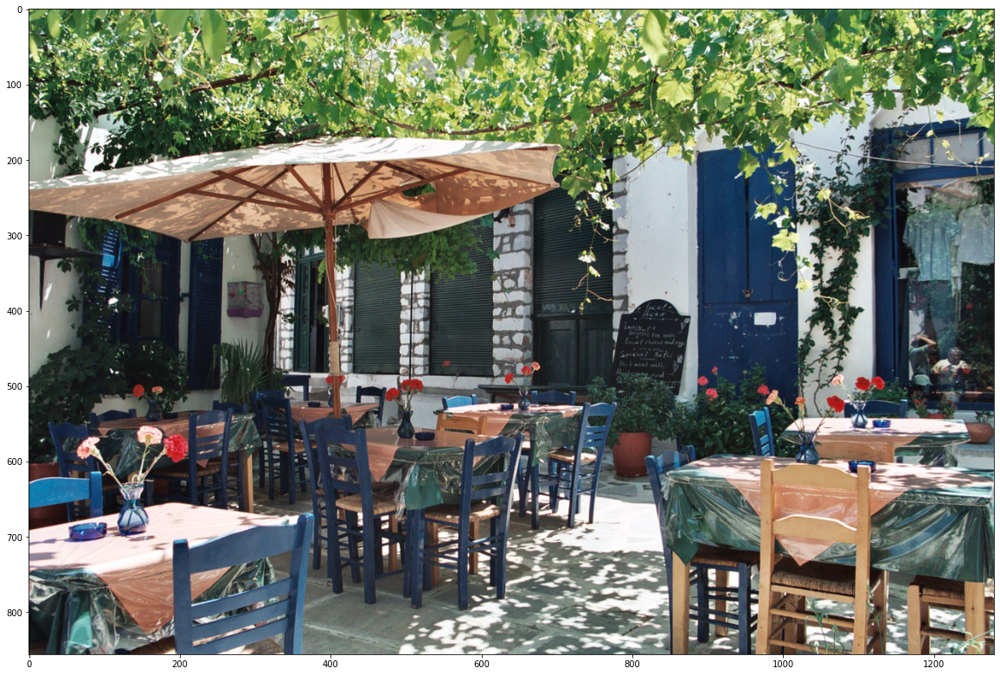

In [ ]:
# Load a public image from Open Images v4, save locally, and display.

# By Heiko Gorski, Source: https://commons.wikimedia.org/wiki/File:Naxos_Taverna.jpg
image_url = "https://upload.wikimedia.org/wikipedia/commons/6/60/Naxos_Taverna.jpg"  #@param
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)

In [ ]:
# visualize the predicted bounding boxes, overlaid on top of the image.
# use draw_boxes and draw_bounding_box_on_image to do this.

def draw_bounding_box_on_image(image,
                               y_min,
                               x_min,
                               y_max,
                               x_max,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):
  """
  Adds a bounding box to an image.

  Args:
    image -- the image object.
    y_min, x_min, y_max, x_max -- bouding box coordinates.
    color -- color for the bounding box edges.
    font -- font for class label.
    thickness -- edge thickness of the bounding box.
    display_str_list -- class labels for each object detected.
  
  Returns:
    No return.
  """
  draw = ImageDraw.Draw(image)
  img_width, img_height = image.size

  # scale the bouding box coordinates to the height and width of the image
  (left, top, right, bottom) = (x_min * img_width, y_min * img_height,
                                x_max * img_width, y_max * img_height)
  
  # define the four edges of the detection box
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top), 
             (left, top)], width=thickness, fill=color)
  
  # If the total height of the display string added to the top of the bounding
  # box exceeds the top of the image, stack the string below the bouding box
  # instead of above.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
  # each display_str has a top and bottom margin of 0.05x.
  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height:
    text_bottom = top
  else:
    text_bottom = top + total_display_str_height

  # Reverse list and print from bottom to top.
  for display_str in display_str_list[::-1]:
    text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2* margin),
                    (left + text_width, text_bottom),
                    ],fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str,
              fill="black",
              font=font)
    text_bottom -= text_height - 2 * margin

def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.1):
  """
  Overlay labeled boxes on an image with formatted scores and label names.

  Args: 
    image -- the image as a numpy array
    boxes -- list of detection boxes
    class_names -- list of classes for each detected object
    scores -- numbers showing the model's confidence in detecting that object
    max_boxes -- maximum detection boxes to overlay on the image (default is 10)
    min_score -- minimum score required to display a bounding box

  Returns:
    image -- the image after detection boxes and classes are overlaid on the ogirinal
    image
  """
  colors = list(ImageColor.colormap.values())

  try:
    font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
                              25)
  except IOError:
    print("Font not found, using default font.")
    font = ImageFont.load_default()

  for i in range(min(boxes.shape[0], max_boxes)):
    # only display detection boxes that have the minimum score or higher
    if scores[i] >= min_score:
      y_min, x_min, y_max, x_max = tuple(boxes[i])
      display_str = "{}: {}".format(class_names[i].decode("ascii"),
                                    int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert("RGB")

      # draw one bounding box and overlay the class labels onto the image
      draw_bounding_box_on_image(image_pil,
                                 y_min, x_min, y_max, x_max,
                                 color, font, display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))

  return image

In [ ]:
def load_img(path):
  """
  Loads a JPEG image and converts it to a tensor.

  Args:
    path (string) -- path to a locally saved JPEG image

  Returns:
    (tensor) -- an image tensor
  """
  # read the file
  img = tf.io.read_file(path)

  # convert to a tensor
  img = tf.image.decode_jpeg(img, channels=3)

  return img

# function to detect objects
def run_detector(detector, path):
  """
  Runs inference on a local file using an object detection model.

  Args:
    detector (model) -- an object detection model loaded from TF Hub.
    path (string) -- path to an image saved locally
  """
  # load an image tensor from a local file path
  img = load_img(path)

  # add a batch dimension in front of the tensor
  converted_img = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]

  # run inference using the model
  start_time = time.time()
  result = detector(converted_img)
  end_time = time.time()

  # save the results in a dictionary
  result = {key: value.numpy() for key, value in result.items()}

  # print results
  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time - start_time)

  # draw predicted boxes over the image
  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"]
  )

  # display the image
  display_image(image_with_boxes)

Found 100 objects.
Inference time:  11.893707275390625


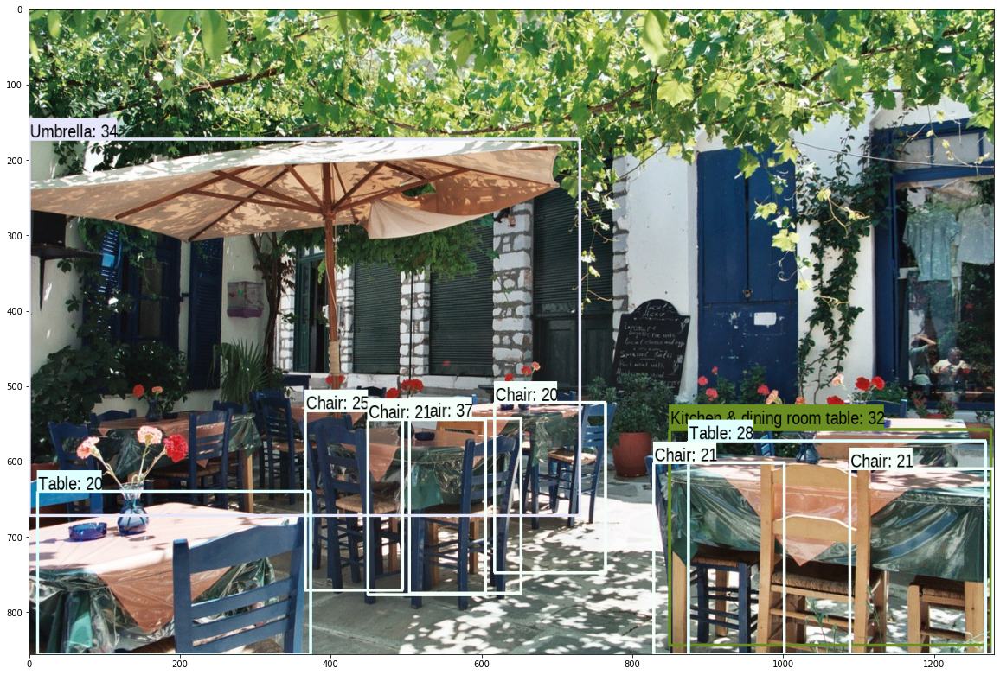

In [ ]:
# Run the detector on your selected image!
run_detector(detector, downloaded_image_path)

Run the detector on more images.

In [ ]:
# Perform inference on some additional images of your choice and check how long inference takes.

image_urls = [
  # Source: https://commons.wikimedia.org/wiki/File:The_Coleoptera_of_the_British_islands_(Plate_125)_(8592917784).jpg
  "https://upload.wikimedia.org/wikipedia/commons/1/1b/The_Coleoptera_of_the_British_islands_%28Plate_125%29_%288592917784%29.jpg",
  # By Américo Toledano, Source: https://commons.wikimedia.org/wiki/File:Biblioteca_Maim%C3%B3nides,_Campus_Universitario_de_Rabanales_007.jpg
  "https://upload.wikimedia.org/wikipedia/commons/thumb/0/0d/Biblioteca_Maim%C3%B3nides%2C_Campus_Universitario_de_Rabanales_007.jpg/1024px-Biblioteca_Maim%C3%B3nides%2C_Campus_Universitario_de_Rabanales_007.jpg",
  # Source: https://commons.wikimedia.org/wiki/File:The_smaller_British_birds_(8053836633).jpg
  "https://upload.wikimedia.org/wikipedia/commons/0/09/The_smaller_British_birds_%288053836633%29.jpg",
  ]

def detect_img(image_url):
    start_time = time.time()
    image_path = download_and_resize_image(image_url, 640, 480)
    run_detector(detector, image_path)
    end_time = time.time()
    print("Inference time:",end_time-start_time)

Image downloaded to /tmp/tmpp4hzeios.jpg.
Found 100 objects.
Inference time:  0.3201627731323242
Inference time: 0.49653005599975586


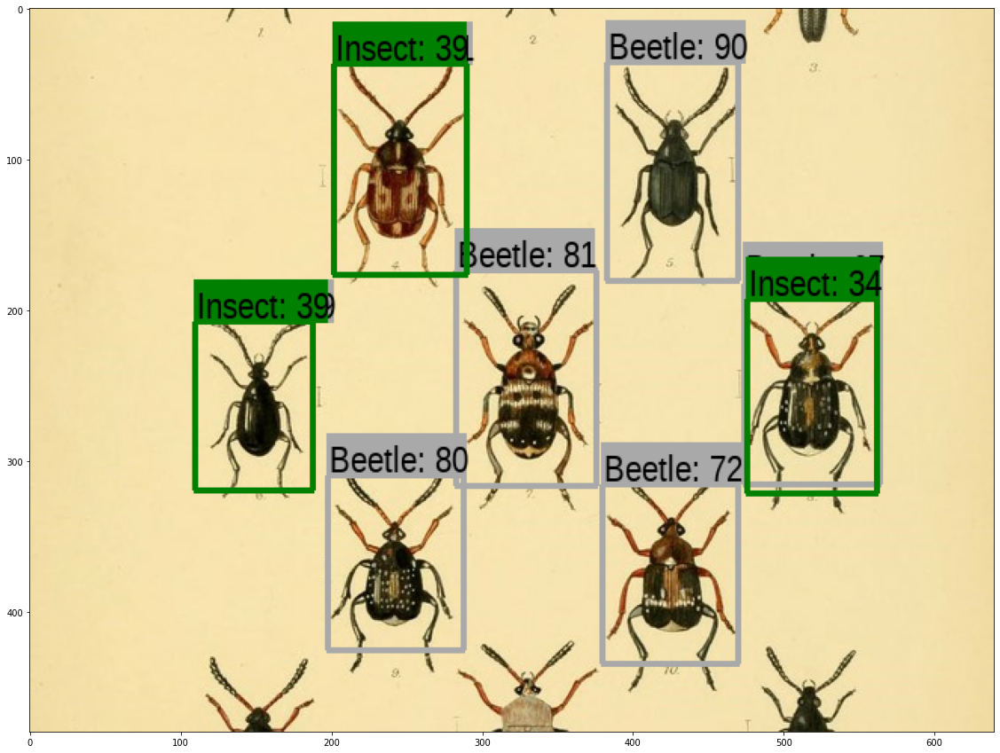

In [ ]:
detect_img(image_urls[0])

Image downloaded to /tmp/tmpa3_uj1rb.jpg.
Found 100 objects.
Inference time:  0.5240402221679688
Inference time: 0.7122797966003418


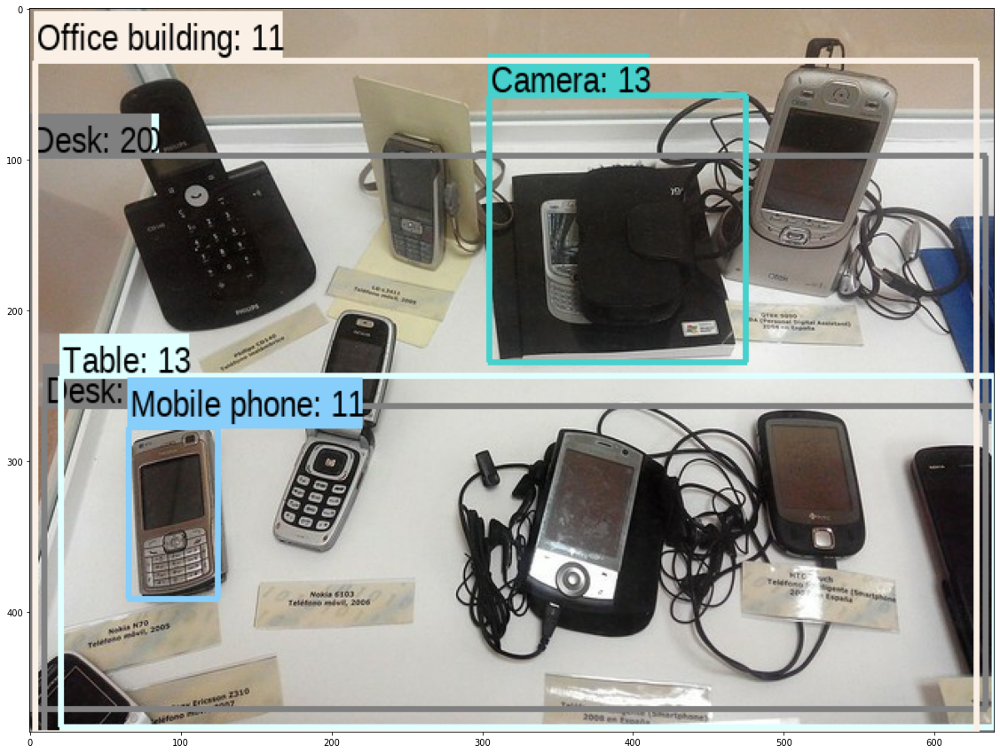

In [ ]:
detect_img(image_urls[1])

Image downloaded to /tmp/tmp4un9by3z.jpg.
Found 100 objects.
Inference time:  0.287198543548584
Inference time: 0.5338485240936279


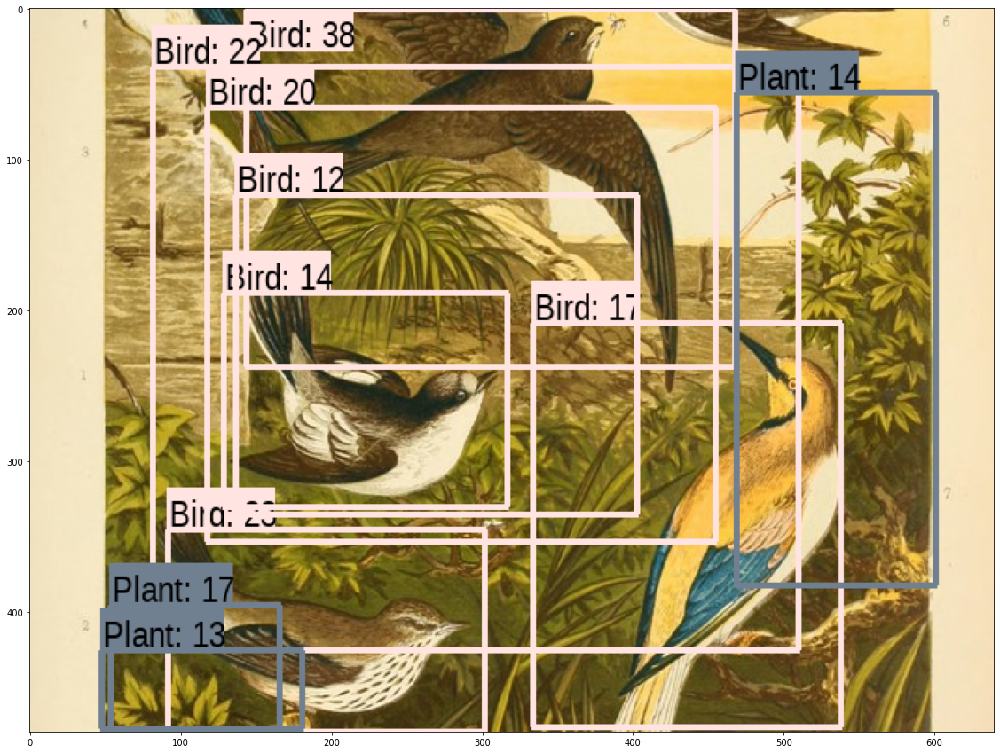

In [ ]:
detect_img(image_urls[2])

Official tutorial for practicing with object detection API for Tensorflow(for Inference only): https://colab.research.google.com/github/tensorflow/hub/blob/master/examples/colab/tf2_object_detection.ipynb.

More about object detection API here: https://github.com/tensorflow/models/tree/master/research/object_detection.

## Example 3. Custom Object Detection with Retina Net on a very small Rubby Duckers Dataset.

We are going to create our own object detection model here. Instead of the training a new model from scratch, we will use transfer learning with a single-stage detection architecture called RetinaNet. The important thing to note with RetinaNet on the output layer is that there is a class subnet where the classification happens and a box subnet that predicts the locations of the bounding boxes. In this example, we'll transfer learn from RetinaNet keeping everything intact except for the class subnets, which will re-train for our dataset. For this example, instead of taking the model out of the hub, we can use a configuration file that defines the model and then, we'll initialize the model using saved checkpoints. This is a way of separating the model architecture from its trained weights, and this is often used in research.

In [ ]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3632, done.
remote: Counting objects: 100% (3632/3632), done.
remote: Compressing objects: 100% (3023/3023), done.
remote: Total 3632 (delta 961), reused 1517 (delta 554), pack-reused 0
Receiving objects: 100% (3632/3632), 47.12 MiB | 18.96 MiB/s, done.
Resolving deltas: 100% (961/961), done.


Check some of config files, which are here now, in this path: /content/models/research/object_detection/configs/tf2. Also, see below how we can load a model from the tensorflow model garden, unzip it and take one of its checkpoints for our task. That 2 actions are the most important in this process.

In [ ]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1696518 sha256=86f92e35085e63831b719ffbd703894741fd175646f99dd6ad3d83b5579fbea8
  Stored in directory: /tmp/pip-ephem-wheel-cache-qlxj6hph/wheels/7d/96/c1/072a751379735e8dfdada1def1c62a89afb3cc45654fd6fd28
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=f9bedd35af20e1cafc27298c2e41b5e06bd213f1f32272a14ccceb2e424663c5
  Stored in directory: /root/.cache/pip/wheels/07/35/78/e9004fa30578734db7f10e7a211605f3f0778d2bdde38a239d
  Created wheel for avro-python3: filename=avro_python3-1.10.2-py3-none-any.whl size=44009 sha256=369234d098570d08f329a16997e25272ba2338b115f2bf2fc10d93d75a0d7477
  Stored in directory: /root/.cache/pip/wheels/bb/73/e9/d273421f5723c4bf544dcf9eb097bda94421ef8d3252699f0a
  Created wheel for docopt: filename=docopt-

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.


In [ ]:
# imports
import matplotlib
import matplotlib.pyplot as plt

import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import colab_utils
from object_detection.builders import model_builder

%matplotlib inline

/usr/local/lib/python3.8/dist-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.8.0 and strictly below 2.11.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.11.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


In [ ]:
# helper functions
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path.

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    figsize=(12, 16),
                    image_name=None):
  """Wrapper function to visualize detections.

  Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
      and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
      this function assumes that the boxes to be plotted are groundtruth
      boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
      category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
  """
  image_np_with_annotations = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_annotations,
      boxes,
      classes,
      scores,
      category_index,
      use_normalized_coordinates=True,
      min_score_thresh=0.8)
  if image_name:
    plt.imsave(image_name, image_np_with_annotations)
  else:
    plt.imshow(image_np_with_annotations)

As our training data, we will use just 5 images of a rubber ducky, which are in the directory: /content/models/research/object_detection/test_images/ducky. Note that the coco dataset, in which Retina Net is trained on, contains a number of animals, but notably, it does not contain rubber duckies (or even ducks for that matter), so our job is to train a classifier that recognizes and detects on an image rubber duckies by using Retina Net!

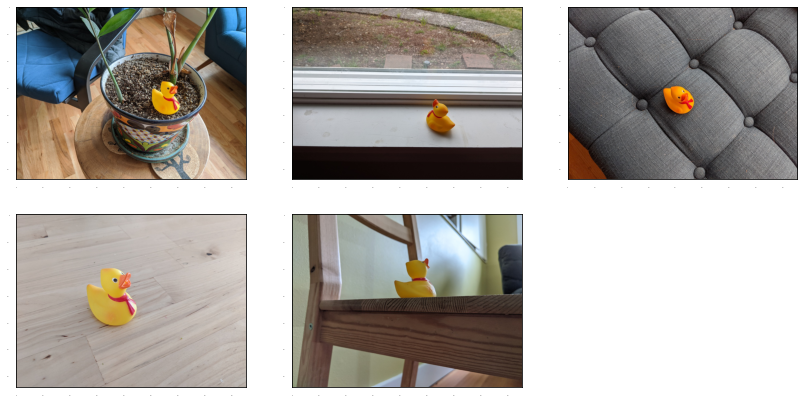

In [ ]:
# Load images and visualize
train_image_dir = 'models/research/object_detection/test_images/ducky/train/'
train_images_np = []
for i in range(1, 6):
  image_path = os.path.join(train_image_dir, 'robertducky' + str(i) + '.jpg')
  train_images_np.append(load_image_into_numpy_array(image_path))

plt.rcParams['axes.grid'] = False
plt.rcParams['xtick.labelsize'] = False
plt.rcParams['ytick.labelsize'] = False
plt.rcParams['xtick.top'] = False
plt.rcParams['xtick.bottom'] = False
plt.rcParams['ytick.left'] = False
plt.rcParams['ytick.right'] = False
plt.rcParams['figure.figsize'] = [14, 7]

for idx, train_image_np in enumerate(train_images_np):
  plt.subplot(2, 3, idx+1)
  plt.imshow(train_image_np)
plt.show()

In [ ]:
# annotate these images with bounding boxes
gt_boxes = []
colab_utils.annotate(train_images_np, box_storage_pointer=gt_boxes)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

'--boxes array populated--'

<IPython.core.display.Javascript object>

In [ ]:
# let's see if we have bboxes
gt_boxes

[array([[0.41273958, 0.57913247, 0.63107292, 0.72919109]]),
 array([[0.52273958, 0.57678781, 0.74773958, 0.71395076]]),
 array([[0.34273958, 0.33059789, 0.79773958, 0.60609613]]),
 array([[0.28107292, 0.28722157, 0.66107292, 0.54044549]]),
 array([[0.22273958, 0.43845252, 0.60107292, 0.63892145]])]

In [ ]:
# Prepare data for training

# Below we add the class annotations (for simplicity, we assume a single class in this colab; though it should be straightforward to extend
# this to handle multiple classes). We also convert everything to the format that the training loop below expects (e.g., everything converted
# to tensors, classes converted to one-hot representations, etc.).

# By convention, our non-background classes start counting at 1.  Given
# that we will be predicting just one class, we will therefore assign it a
# `class id` of 1.
duck_class_id = 1
num_classes = 1

category_index = {duck_class_id: {'id': duck_class_id, 'name': 'rubber_ducky'}}

# Convert class labels to one-hot; convert everything to tensors.
# The `label_id_offset` here shifts all classes by a certain number of indices;
# we do this here so that the model receives one-hot labels where non-background
# classes start counting at the zeroth index.  This is ordinarily just handled
# automatically in our training binaries, but we need to reproduce it here.
label_id_offset = 1
train_image_tensors = []
gt_classes_one_hot_tensors = []
gt_box_tensors = []
for (train_image_np, gt_box_np) in zip(train_images_np, gt_boxes):
  train_image_tensors.append(tf.expand_dims(tf.convert_to_tensor(train_image_np, dtype=tf.float32), axis=0))
  gt_box_tensors.append(tf.convert_to_tensor(gt_box_np, dtype=tf.float32))
  zero_indexed_groundtruth_classes = tf.convert_to_tensor(np.ones(shape=[gt_box_np.shape[0]], dtype=np.int32) - label_id_offset)
  gt_classes_one_hot_tensors.append(tf.one_hot(zero_indexed_groundtruth_classes, num_classes))
print('Done preparing data.')

Done preparing data.


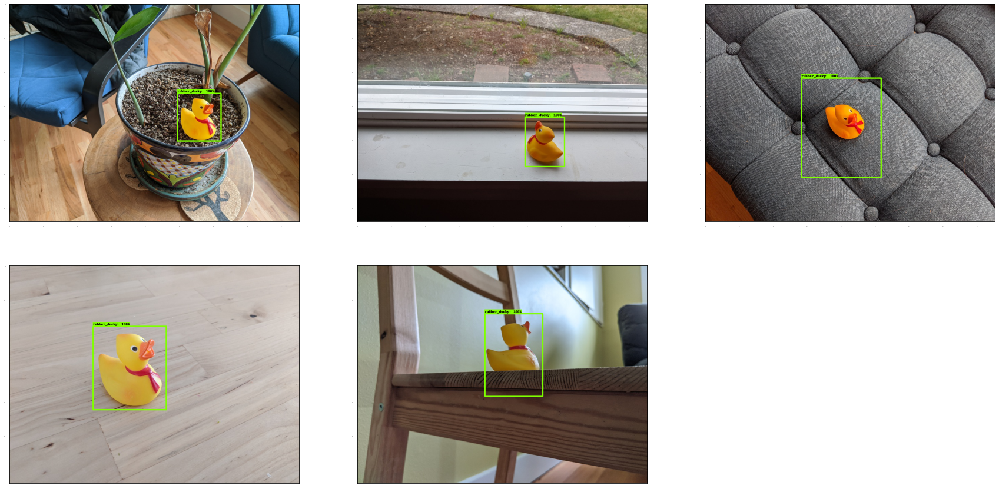

In [ ]:
# let's just visualize the rubber duckies as a sanity check

dummy_scores = np.array([1.0], dtype=np.float32)  # give boxes a score of 100%

plt.figure(figsize=(30, 15))
for idx in range(5):
  plt.subplot(2, 3, idx+1)
  plot_detections(
      train_images_np[idx],
      gt_boxes[idx],
      np.ones(shape=[gt_boxes[idx].shape[0]], dtype=np.int32),
      dummy_scores, category_index)
plt.show()

Create model and restore weights for all but last (classification)layer.

In [ ]:
# Download the checkpoint and put it into models/research/object_detection/test_data/
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
!tar -xf ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
!mv ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint models/research/object_detection/test_data/

--2022-12-08 18:11:04--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 142.250.153.128, 2a00:1450:4013:c16::80
Connecting to download.tensorflow.org (download.tensorflow.org)|142.250.153.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 244817203 (233M) [application/x-tar]
Saving to: ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’

ssd_resnet50_v1_fpn 100%[===================>] 233.48M   128MB/s    in 1.8s    

2022-12-08 18:11:07 (128 MB/s) - ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’ saved [244817203/244817203]



You can check if the checkpoints exist in the directory.

We have also assumed that the image size will always be 640x640! 

In [ ]:
tf.keras.backend.clear_session()

# define 3 things: how many classes we have, the config path and the checkpoint path
print('Building model and restoring weights for fine-tuning...', flush=True)
num_classes = 1
pipeline_config = 'models/research/object_detection/configs/tf2/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.config'
checkpoint_path = 'models/research/object_detection/test_data/checkpoint/ckpt-0'

# and change that 3 things where is needed !!

# Load pipeline config and build a detection model.
#
# Since we are working off of a COCO architecture which predicts 90
# class slots by default, we override the `num_classes` field here to be just
# one (for our new rubber ducky class).
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
model_config.ssd.num_classes = num_classes  # overide the default num of classes(90) with our num_classes
model_config.ssd.freeze_batchnorm = True
detection_model = model_builder.build(    # initialize a new model by passing the config file we just modified
      model_config=model_config, is_training=True)  # this is an empty model with no weights yet!

# Set up object-based checkpoint restore --- RetinaNet has two prediction
# `heads` --- one for classification, the other for box regression.  We will
# restore the box regression head but initialize the classification head
# from scratch (we show the omission below by commenting out the line that
# we would add if we wanted to restore both heads)
fake_box_predictor = tf.compat.v2.train.Checkpoint(
    _base_tower_layers_for_heads=detection_model._box_predictor._base_tower_layers_for_heads,
    # _prediction_heads=detection_model._box_predictor._prediction_heads,
    #    (i.e., the classification head that we *will not* restore)
    _box_prediction_head=detection_model._box_predictor._box_prediction_head,
    )
fake_model = tf.compat.v2.train.Checkpoint(
          _feature_extractor=detection_model._feature_extractor,
          _box_predictor=fake_box_predictor)
ckpt = tf.compat.v2.train.Checkpoint(model=fake_model)
ckpt.restore(checkpoint_path).expect_partial()

# Run model through a dummy image so that variables are created
image, shapes = detection_model.preprocess(tf.zeros([1, 640, 640, 3])) # that is the input size for the model we downloaded
prediction_dict = detection_model.predict(image, shapes)
_ = detection_model.postprocess(prediction_dict, shapes)
print('Weights restored!')

Building model and restoring weights for fine-tuning...
Weights restored!


More about Retina Net: https://arxiv.org/abs/1708.02002.

Recall that the retina net model has two subnets that perform two different tasks. We'll refer to each of these subnets as heads going forward. One of these heads is the class subnet. Which predicts the class or the category of the identified object. The second head, which is the box of net predicts the bounding boxes that identify where the image the object is located. You're going to reuse the bounding box head, but you'll create new layers for predicting the Class.

See here how to modify the pre-trained model for our task(Laurence gives us a great analysis of most important steps here):

https://www.coursera.org/learn/advanced-computer-vision-with-tensorflow/lecture/jKPMG/loading-a-retinanet-model

https://www.coursera.org/learn/advanced-computer-vision-with-tensorflow/lecture/k3UjZ/loading-weights

https://www.coursera.org/learn/advanced-computer-vision-with-tensorflow/lecture/PVaTB/data-prep-and-training-overview

https://www.coursera.org/learn/advanced-computer-vision-with-tensorflow/lecture/Yj69C/custom-training-loop-code

In [ ]:
# Custom training loop
tf.keras.backend.set_learning_phase(True)

# These parameters can be tuned; since our training set has 5 images
# it doesn't make sense to have a much larger batch size, though we could
# fit more examples in memory if we wanted to.
batch_size = 4
learning_rate = 0.01
num_batches = 100

# Select variables in top layers to fine-tune.
trainable_variables = detection_model.trainable_variables
to_fine_tune = []
prefixes_to_train = [
  'WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalBoxHead',
  'WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalClassHead']
for var in trainable_variables:
  if any([var.name.startswith(prefix) for prefix in prefixes_to_train]):
    to_fine_tune.append(var)

# Set up forward + backward pass for a single train step.
def get_model_train_step_function(model, optimizer, vars_to_fine_tune):
  """Get a tf.function for training step."""

  # Use tf.function for a bit of speed.
  # Comment out the tf.function decorator if you want the inside of the
  # function to run eagerly.
  @tf.function
  def train_step_fn(image_tensors,
                    groundtruth_boxes_list,
                    groundtruth_classes_list):
    """A single training iteration.

    Args:
      image_tensors: A list of [1, height, width, 3] Tensor of type tf.float32.
        Note that the height and width can vary across images, as they are
        reshaped within this function to be 640x640.
      groundtruth_boxes_list: A list of Tensors of shape [N_i, 4] with type
        tf.float32 representing groundtruth boxes for each image in the batch.
      groundtruth_classes_list: A list of Tensors of shape [N_i, num_classes]
        with type tf.float32 representing groundtruth boxes for each image in
        the batch.

    Returns:
      A scalar tensor representing the total loss for the input batch.
    """
    shapes = tf.constant(batch_size * [[640, 640, 3]], dtype=tf.int32)
    model.provide_groundtruth(
        groundtruth_boxes_list=groundtruth_boxes_list,
        groundtruth_classes_list=groundtruth_classes_list)
    with tf.GradientTape() as tape:
      preprocessed_images = tf.concat(
          [detection_model.preprocess(image_tensor)[0]
           for image_tensor in image_tensors], axis=0)
      prediction_dict = model.predict(preprocessed_images, shapes)
      losses_dict = model.loss(prediction_dict, shapes)
      total_loss = losses_dict['Loss/localization_loss'] + losses_dict['Loss/classification_loss']
      gradients = tape.gradient(total_loss, vars_to_fine_tune)
      optimizer.apply_gradients(zip(gradients, vars_to_fine_tune))
    return total_loss

  return train_step_fn

optimizer = tf.keras.optimizers.SGD(learning_rate=learning_rate, momentum=0.9)
train_step_fn = get_model_train_step_function(
    detection_model, optimizer, to_fine_tune)

print('Start fine-tuning!', flush=True)
for idx in range(num_batches):
  # Grab keys for a random subset of examples
  all_keys = list(range(len(train_images_np)))
  random.shuffle(all_keys)
  example_keys = all_keys[:batch_size]

  # Note that we do not do data augmentation in this demo.  If you want a
  # a fun exercise, we recommend experimenting with random horizontal flipping
  # and random cropping :)
  gt_boxes_list = [gt_box_tensors[key] for key in example_keys]
  gt_classes_list = [gt_classes_one_hot_tensors[key] for key in example_keys]
  image_tensors = [train_image_tensors[key] for key in example_keys]

  # Training step (forward pass + backwards pass)
  total_loss = train_step_fn(image_tensors, gt_boxes_list, gt_classes_list)

  if idx % 10 == 0:
    print('batch ' + str(idx) + ' of ' + str(num_batches)
    + ', loss=' +  str(total_loss.numpy()), flush=True)

print('Done fine-tuning!')

Start fine-tuning!


/usr/local/lib/python3.8/dist-packages/keras/backend.py:451: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn(
Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089


batch 0 of 100, loss=1.522835
batch 10 of 100, loss=0.29734468
batch 20 of 100, loss=0.10803951
batch 30 of 100, loss=0.04655478
batch 40 of 100, loss=0.028103733
batch 50 of 100, loss=0.019046823
batch 60 of 100, loss=0.011974072
batch 70 of 100, loss=0.010227873
batch 80 of 100, loss=0.009097651
batch 90 of 100, loss=0.008370049
Done fine-tuning!


In [ ]:
# Load test images and run inference with new model!

test_image_dir = 'models/research/object_detection/test_images/ducky/test/'
test_images_np = []
for i in range(1, 50):
  image_path = os.path.join(test_image_dir, 'out' + str(i) + '.jpg')
  test_images_np.append(np.expand_dims(
      load_image_into_numpy_array(image_path), axis=0))

# Again, uncomment this decorator if you want to run inference eagerly
@tf.function
def detect(input_tensor):
  """Run detection on an input image.

  Args:
    input_tensor: A [1, height, width, 3] Tensor of type tf.float32.
      Note that height and width can be anything since the image will be
      immediately resized according to the needs of the model within this
      function.

  Returns:
    A dict containing 3 Tensors (`detection_boxes`, `detection_classes`,
      and `detection_scores`).
  """
  preprocessed_image, shapes = detection_model.preprocess(input_tensor)
  prediction_dict = detection_model.predict(preprocessed_image, shapes)
  return detection_model.postprocess(prediction_dict, shapes)

# Note that the first frame will trigger tracing of the tf.function, which will
# take some time, after which inference should be fast.

label_id_offset = 1
for i in range(len(test_images_np)):
  input_tensor = tf.convert_to_tensor(test_images_np[i], dtype=tf.float32)
  detections = detect(input_tensor)

  plot_detections(
      test_images_np[i][0],
      detections['detection_boxes'][0].numpy(),
      detections['detection_classes'][0].numpy().astype(np.uint32)
      + label_id_offset,
      detections['detection_scores'][0].numpy(),
      category_index, figsize=(15, 20), image_name="gif_frame_" + ('%02d' % i) + ".jpg")

Imageio: 'libfreeimage-3.16.0-linux64.so' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/freeimage/libfreeimage-3.16.0-linux64.so (4.6 MB)
Downloading: 8192/4830080 bytes (0.2%)4830080/4830080 bytes (100.0%)
  Done
File saved as /root/.imageio/freeimage/libfreeimage-3.16.0-linux64.so.


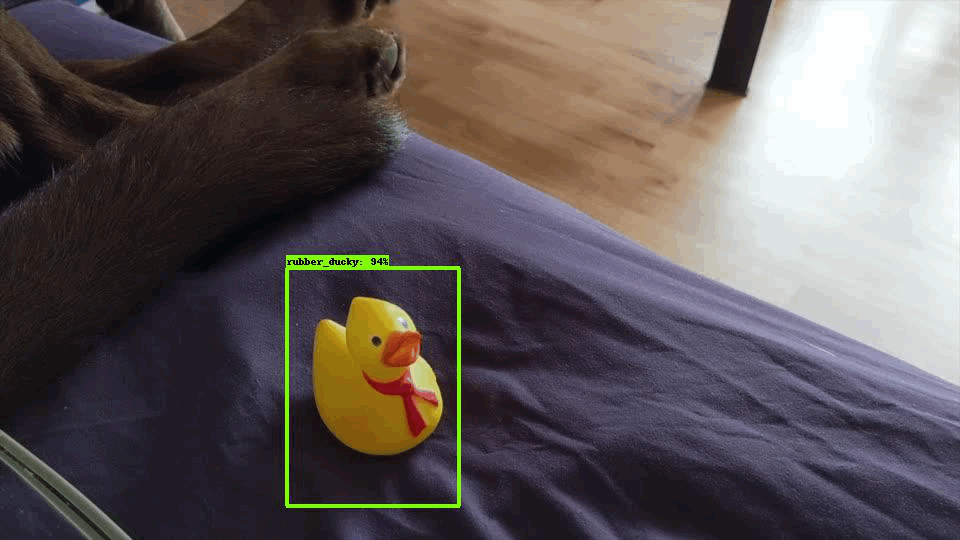

In [ ]:
# create a detection gif
imageio.plugins.freeimage.download()

anim_file = 'duckies_test.gif'

filenames = glob.glob('gif_frame_*.jpg')
filenames = sorted(filenames)
last = -1
images = []
for filename in filenames:
  image = imageio.imread(filename)
  images.append(image)

imageio.mimsave(anim_file, images, 'GIF-FI', fps=5)

display(IPyImage(open(anim_file, 'rb').read()))

This is the official tutorial to practice using the Object Detection API and training a pre-trained model: https://colab.research.google.com/github/tensorflow/models/blob/master/research/object_detection/colab_tutorials/eager_few_shot_od_training_tf2_colab.ipynb.

## Example 4. Custom Object Detection with Retina Net on a very small Zombie Dataset.


We will use the Object Detection API and retrain RetinaNet to spot Zombies using just 5 training images. We will setup the model to restore pretrained weights and fine tune the classification layers.

We follow the same process as in example 3.

In [1]:
# uncomment the next line if you want to delete an existing models directory
!rm -rf ./models/

import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3632, done.
remote: Counting objects: 100% (3632/3632), done.
remote: Compressing objects: 100% (3024/3024), done.
remote: Total 3632 (delta 960), reused 1524 (delta 553), pack-reused 0
Receiving objects: 100% (3632/3632), 47.12 MiB | 24.72 MiB/s, done.
Resolving deltas: 100% (960/960), done.
Checking out files: 100% (3289/3289), done.


In [2]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1696518 sha256=c528d4aa9a61db754494c516a1fedec0d9beecad6bf4db7e99b27adf0b62ca5f
  Stored in directory: /tmp/pip-ephem-wheel-cache-jw0xyeds/wheels/7d/96/c1/072a751379735e8dfdada1def1c62a89afb3cc45654fd6fd28
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=2d7ef4797c2f878f6e239d2e9935ef532279f0dd7b14977114b9be1d51449659
  Stored in directory: /root/.cache/pip/wheels/07/35/78/e9004fa30578734db7f10e7a211605f3f0778d2bdde38a239d
  Created wheel for avro-python3: filename=avro_python3-1.10.2-py3-none-any.whl size=44009 sha256=129e42c60c1d59b38d4bca55008717a0e272509f6f2922716a36759e47de0d51
  Stored in directory: /root/.cache/pip/wheels/bb/73/e9/d273421f5723c4bf544dcf9eb097bda94421ef8d3252699f0a
  Created wheel for docopt: filename=docopt-

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.


In [3]:
# imports
import matplotlib
import matplotlib.pyplot as plt
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage
import zipfile
import tensorflow as tf
%matplotlib inline

In [4]:
# Import useful Object Detection API packages

# import the label map utility module
from object_detection.utils import label_map_util

# import module for reading and updating configuration files.
from object_detection.utils import config_util

# import module for visualization. use the alias `viz_utils`
from object_detection.utils import visualization_utils  as viz_utils

# import module for building the detection model
from object_detection.builders import model_builder

# import module for utilities in Colab
from object_detection.utils import colab_utils

/usr/local/lib/python3.8/dist-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.8.0 and strictly below 2.11.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.11.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


In [5]:
# functions for loading images and plotting detections

def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.

    Puts image into numpy array to feed into tensorflow graph.
    Note that by convention we put it into a numpy array with shape
    (height, width, channels), where channels=3 for RGB.

    Args:
    path: a file path.

    Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
    """
    
    img_data = tf.io.gfile.GFile(path, 'rb').read()
    image = Image.open(BytesIO(img_data))
    (im_width, im_height) = image.size
    
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)


def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    figsize=(12, 16),
                    image_name=None):
    """Wrapper function to visualize detections.

    Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
          and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
          this function assumes that the boxes to be plotted are groundtruth
          boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
          category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
    """
    
    image_np_with_annotations = image_np.copy()
    
    viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_annotations,
        boxes,
        classes,
        scores,
        category_index,
        use_normalized_coordinates=True,
        min_score_thresh=0.8)
    
    if image_name:
        plt.imsave(image_name, image_np_with_annotations)
    
    else:
        plt.imshow(image_np_with_annotations)

In [8]:
# download the Zombie data

# download the images
!wget --no-check-certificate \
    https://storage.googleapis.com/laurencemoroney-blog.appspot.com/training-zombie.zip \
    -O ./training-zombie.zip

# unzip to a local directory
local_zip = './training-zombie.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('./training')
zip_ref.close()

--2022-12-09 06:24:29--  https://storage.googleapis.com/laurencemoroney-blog.appspot.com/training-zombie.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.132.128, 74.125.202.128, 74.125.69.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.132.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1915446 (1.8M) [application/zip]
Saving to: ‘./training-zombie.zip’

./training-zombie.z 100%[===================>]   1.83M  --.-KB/s    in 0.02s   

2022-12-09 06:24:29 (97.3 MB/s) - ‘./training-zombie.zip’ saved [1915446/1915446]



./training/training-zombie1.jpg
./training/training-zombie2.jpg
./training/training-zombie3.jpg
./training/training-zombie4.jpg
./training/training-zombie5.jpg


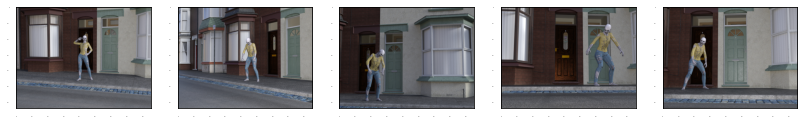

In [10]:
# visualize the training images
%matplotlib inline

# assign the name (string) of the directory containing the training images
train_image_dir = './training'
train_image_prefix_name = "training-zombie"
# declare an empty list
train_images_np = []

# run a for loop for each image
for i in range(1, 6):

    # define the path (string) for each image
    image_path = os.path.join(train_image_dir, train_image_prefix_name+ 
                              str(i) + ".jpg")
    print(image_path)

    # load images into numpy arrays and append to a list
    train_images_np.append(load_image_into_numpy_array(image_path))

# configure plot settings via rcParams
plt.rcParams['axes.grid'] = False
plt.rcParams['xtick.labelsize'] = False
plt.rcParams['ytick.labelsize'] = False
plt.rcParams['xtick.top'] = False
plt.rcParams['xtick.bottom'] = False
plt.rcParams['ytick.left'] = False
plt.rcParams['ytick.right'] = False
plt.rcParams['figure.figsize'] = [14, 7]

# plot images
for idx, train_image_np in enumerate(train_images_np):
    plt.subplot(1, 5, idx+1)
    plt.imshow(train_image_np)

plt.show()

In [11]:
# now, we create our ground truth boxes

# Define the list of ground truth boxes
gt_boxes = []

# annotate the training images
colab_utils.annotate(train_images_np, box_storage_pointer=gt_boxes)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

'--boxes array populated--'

<IPython.core.display.Javascript object>

In [12]:
# print the coordinates of our ground truth boxes
for gt_box in gt_boxes:
  print(gt_box)

[[0.27273958 0.41500586 0.75107292 0.58382181]]
[[0.29107292 0.45134818 0.77440625 0.62016413]]
[[0.40107292 0.18171161 0.95773958 0.35404455]]
[[0.10940625 0.61664713 0.80440625 0.91793669]]
[[0.24607292 0.12895662 0.83273958 0.35873388]]


In [13]:
# define the category index dictioary. If there is ever a 'background' class, it could be assigned the integer 0, but in this case,
# you're just predicting the one zombie class. Since you are just predicting one class (zombie), we assign 1 to the zombie class ID.

# Assign the zombie class ID
zombie_class_id = 1

# define a dictionary describing the zombie class
category_index = {
    zombie_class_id:{
        'id': zombie_class_id,
        'name': 'zombie'
    }
}

# Specify the number of classes that the model will predict
num_classes = 1

In [14]:
print(category_index[zombie_class_id])

{'id': 1, 'name': 'zombie'}


Data preprocessing here includes 1) one-hot encoding for the labels and 2) converting everything to tensors. 

In [15]:
# The `label_id_offset` here shifts all classes by a certain number of indices;
# we do this here so that the model receives one-hot labels where non-background
# classes start counting at the zeroth index.  This is ordinarily just handled
# automatically in our training binaries, but we need to reproduce it here.

label_id_offset = 1
train_image_tensors = []

# lists containing the one-hot encoded classes and ground truth boxes
gt_classes_one_hot_tensors = []
gt_box_tensors = []

for (train_image_np, gt_box_np) in zip(train_images_np, gt_boxes):
    
    # convert training image to tensor, add batch dimension, and add to list
    train_image_tensors.append(tf.expand_dims(tf.convert_to_tensor(
        train_image_np, dtype=tf.float32), axis=0))
    
    # convert numpy array to tensor, then add to list
    gt_box_tensors.append(tf.convert_to_tensor(gt_box_np, dtype=tf.float32))
    
    # apply offset to to have zero-indexed ground truth classes
    zero_indexed_groundtruth_classes = tf.convert_to_tensor(
        np.ones(shape=[gt_box_np.shape[0]], dtype=np.int32) - label_id_offset)
    
    # do one-hot encoding to ground truth classes
    gt_classes_one_hot_tensors.append(tf.one_hot(
        zero_indexed_groundtruth_classes, num_classes))

print('Done prepping data.')

Done prepping data.


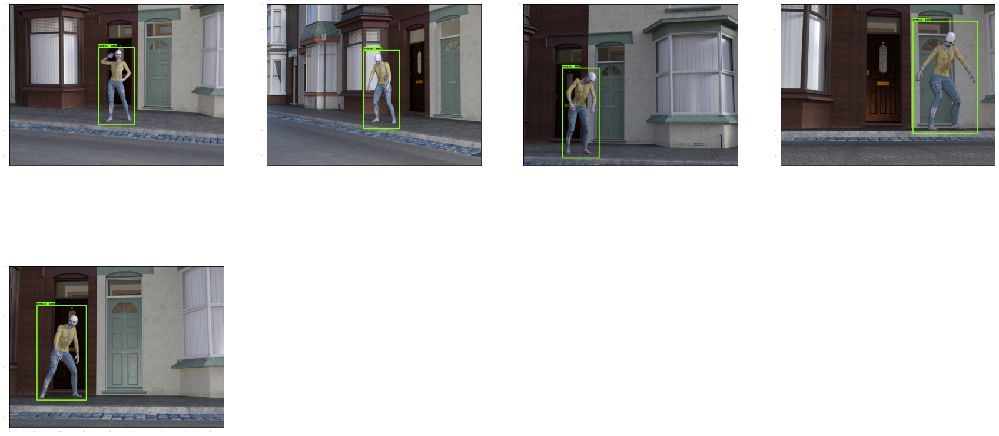

In [16]:
# visualize the boxes with their bboxes

# give boxes a score of 100%
dummy_scores = np.array([1.0], dtype=np.float32)

# define the figure size
plt.figure(figsize=(30, 15))

# use the `plot_detections()` utility function to draw the ground truth boxes
for idx in range(5):
    plt.subplot(2, 4, idx+1)
    plot_detections(
      train_images_np[idx],
      gt_boxes[idx],
      np.ones(shape=[gt_boxes[idx].shape[0]], dtype=np.int32),
      dummy_scores, category_index)

plt.show()

When working with models that are at the frontiers of research, the models and checkpoints may not yet be organized in a central location like the TensorFlow Garden (https://github.com/tensorflow/models).


You'll often read a blog post from the researchers, who will usually provide information on: how to use the model and where to download the models and pre-trained checkpoints.

It's good practice to do some of this "detective work", so that you'll feel more comfortable when exploring new models yourself! So please try the following steps:

Go to the TensorFlow Blog(https://blog.tensorflow.org/), where researchers announce new findings. In the search box at the top of the page, search for "retinanet"(or any other model yu prefer). In the search results, click on the blog post titled "TensorFlow 2 meets the Object Detection API" (it may be the first search result). Skim through this blog and look for links to either the checkpoints or to Colabs that will show you how to use the checkpoints.

Download the model.

In [17]:
# download the checkpoint containing the pre-trained weights

# Download the SSD Resnet 50 version 1, 640x640 checkpoint
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
    
# untar (decompress) the tar file
!tar -xf ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz

# copy the checkpoint to the test_data folder models/research/object_detection/test_data/
!cp -r ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint models/research/object_detection/test_data/

--2022-12-09 06:38:52--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 209.85.146.128, 2607:f8b0:4001:c1f::80
Connecting to download.tensorflow.org (download.tensorflow.org)|209.85.146.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 244817203 (233M) [application/x-tar]
Saving to: ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’

ssd_resnet50_v1_fpn 100%[===================>] 233.48M   158MB/s    in 1.5s    

2022-12-09 06:38:53 (158 MB/s) - ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz’ saved [244817203/244817203]



Configure the model.

In [18]:
# Locate and read from the configuration file
tf.keras.backend.clear_session()

# define the path to the .config file for ssd resnet 50 v1 640x640
pipeline_config = '/content/models/research/object_detection/configs/tf2/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.config'

# Load the configuration file into a dictionary
configs = config_util.get_configs_from_pipeline_file(pipeline_config)

# See what configs looks like
configs

{'model': ssd {
   num_classes: 90
   image_resizer {
     fixed_shape_resizer {
       height: 640
       width: 640
     }
   }
   feature_extractor {
     type: "ssd_resnet50_v1_fpn_keras"
     depth_multiplier: 1.0
     min_depth: 16
     conv_hyperparams {
       regularizer {
         l2_regularizer {
           weight: 0.00039999998989515007
         }
       }
       initializer {
         truncated_normal_initializer {
           mean: 0.0
           stddev: 0.029999999329447746
         }
       }
       activation: RELU_6
       batch_norm {
         decay: 0.996999979019165
         scale: true
         epsilon: 0.0010000000474974513
       }
     }
     override_base_feature_extractor_hyperparams: true
     fpn {
       min_level: 3
       max_level: 7
     }
   }
   box_coder {
     faster_rcnn_box_coder {
       y_scale: 10.0
       x_scale: 10.0
       height_scale: 5.0
       width_scale: 5.0
     }
   }
   matcher {
     argmax_matcher {
       matched_threshold: 0.5


In [19]:
# get that part of the above config file which is about our model

# Read in the object stored at the key 'model' of the configs dictionary
model_config = configs["model"]

# see what model_config looks like
model_config

ssd {
  num_classes: 90
  image_resizer {
    fixed_shape_resizer {
      height: 640
      width: 640
    }
  }
  feature_extractor {
    type: "ssd_resnet50_v1_fpn_keras"
    depth_multiplier: 1.0
    min_depth: 16
    conv_hyperparams {
      regularizer {
        l2_regularizer {
          weight: 0.00039999998989515007
        }
      }
      initializer {
        truncated_normal_initializer {
          mean: 0.0
          stddev: 0.029999999329447746
        }
      }
      activation: RELU_6
      batch_norm {
        decay: 0.996999979019165
        scale: true
        epsilon: 0.0010000000474974513
      }
    }
    override_base_feature_extractor_hyperparams: true
    fpn {
      min_level: 3
      max_level: 7
    }
  }
  box_coder {
    faster_rcnn_box_coder {
      y_scale: 10.0
      x_scale: 10.0
      height_scale: 5.0
      width_scale: 5.0
    }
  }
  matcher {
    argmax_matcher {
      matched_threshold: 0.5
      unmatched_threshold: 0.5
      ignore_thresholds: f

In [20]:
# and change just the number of classes

# Modify the number of classes from its default of 90
model_config.ssd.num_classes = num_classes

# Freeze batch normalization
model_config.ssd.freeze_batchnorm = True

# See what model_config now looks like after you've customized it!
model_config

ssd {
  num_classes: 1
  image_resizer {
    fixed_shape_resizer {
      height: 640
      width: 640
    }
  }
  feature_extractor {
    type: "ssd_resnet50_v1_fpn_keras"
    depth_multiplier: 1.0
    min_depth: 16
    conv_hyperparams {
      regularizer {
        l2_regularizer {
          weight: 0.00039999998989515007
        }
      }
      initializer {
        truncated_normal_initializer {
          mean: 0.0
          stddev: 0.029999999329447746
        }
      }
      activation: RELU_6
      batch_norm {
        decay: 0.996999979019165
        scale: true
        epsilon: 0.0010000000474974513
      }
    }
    override_base_feature_extractor_hyperparams: true
    fpn {
      min_level: 3
      max_level: 7
    }
  }
  box_coder {
    faster_rcnn_box_coder {
      y_scale: 10.0
      x_scale: 10.0
      height_scale: 5.0
      width_scale: 5.0
    }
  }
  matcher {
    argmax_matcher {
      matched_threshold: 0.5
      unmatched_threshold: 0.5
      ignore_thresholds: fa

Build the model.

In [21]:
# builf the custom model
detection_model = model_builder.build(model_config, is_training=True)

print(type(detection_model))

<class 'object_detection.meta_architectures.ssd_meta_arch.SSDMetaArch'>


We want to selectively restore weights from our checkpoint. Our end goal is to create a custom model which reuses parts of, but not all of the layers of RetinaNet (currently stored in the variable detection_model). The parts of RetinaNet that we want to reuse are: a) Feature extraction layers and b) Bounding box regression prediction layer. The part of RetinaNet that we do not want to reuse is the classification prediction layer (since we will define and train our own classification layer specific to zombies). For the parts of RetinaNet that we want to reuse, we will also restore the weights from the checkpoint that you selected.

In [22]:
# the type of our detection model
detection_model

How to find the source code of our model: go to models->research->object_detection->meta_architectures and find the above architecture ssd_meta_arch.py and open it.

In [23]:
# check the class variables that are in detection_model
vars(detection_model)

{'_self_setattr_tracking': True,
 '_obj_reference_counts_dict': ObjectIdentityDictionary({<_ObjectIdentityWrapper wrapping False>: 4, <_ObjectIdentityWrapper wrapping 1>: 1, <_ObjectIdentityWrapper wrapping DictWrapper({})>: 1, <_ObjectIdentityWrapper wrapping True>: 7, <_ObjectIdentityWrapper wrapping <object_detection.anchor_generators.multiscale_grid_anchor_generator.MultiscaleGridAnchorGenerator object at 0x7f0fd3137c40>>: 1, <_ObjectIdentityWrapper wrapping <object_detection.predictors.convolutional_keras_box_predictor.WeightSharedConvolutionalBoxPredictor object at 0x7f0fd30da040>>: 1, <_ObjectIdentityWrapper wrapping <object_detection.box_coders.faster_rcnn_box_coder.FasterRcnnBoxCoder object at 0x7f0fd3181280>>: 1, <_ObjectIdentityWrapper wrapping <object_detection.models.ssd_resnet_v1_fpn_keras_feature_extractor.SSDResNet50V1FpnKerasFeatureExtractor object at 0x7f0fd7591820>>: 1, <_ObjectIdentityWrapper wrapping 'ResNet50V1_FPN'>: 1, <_ObjectIdentityWrapper wrapping <tf.Tensor

2 of them are relevant to us and want to reuse: box_predictor and feature_extractor.

In [24]:
# view the type of _box_predictor
detection_model._box_predictor

the class type of _box_predictor is: object_detection.predictors.convolutional_keras_box_predictor.WeightSharedConvolutionalBoxPredictor

Go to https://github.com/tensorflow/models/tree/master/research/object_detection/predictors and open the file file named convolutional_keras_box_predictor.py.

In [25]:
# view the variables contained in _box_predictor:
vars(detection_model._box_predictor)

{'_self_setattr_tracking': True,
 '_obj_reference_counts_dict': ObjectIdentityDictionary({<_ObjectIdentityWrapper wrapping False>: 5, <_ObjectIdentityWrapper wrapping True>: 3, <_ObjectIdentityWrapper wrapping 1>: 1, <_ObjectIdentityWrapper wrapping <object_detection.predictors.heads.keras_box_head.WeightSharedConvolutionalBoxHead object at 0x7f0fd3137a30>>: 1, <_ObjectIdentityWrapper wrapping DictWrapper({'class_predictions_with_background': <object_detection.predictors.heads.keras_class_head.WeightSharedConvolutionalClassHead object at 0x7f0fd30daa30>})>: 1, <_ObjectIdentityWrapper wrapping ListWrapper(['class_predictions_with_background'])>: 1, <_ObjectIdentityWrapper wrapping <object_detection.builders.hyperparams_builder.KerasLayerHyperparams object at 0x7f0fd3137b20>>: 1, <_ObjectIdentityWrapper wrapping 256>: 1, <_ObjectIdentityWrapper wrapping 4>: 1, <_ObjectIdentityWrapper wrapping 3>: 1, <_ObjectIdentityWrapper wrapping ListWrapper([])>: 1, <_ObjectIdentityWrapper wrapping Di

3 of them are relevant to us: _base_tower_layers_for_heads, 
_box_prediction_head and _prediction_heads. See in the above .py file what they do.

The detection_model.box_predictor._base_tower_layers_for_heads contains:

The layers for the prediction before the final bounding box prediction and the layers for the prediction before the final class prediction, which we'll want to use for our model.

The detection_model.box_predictor._box_prediction_head points to the bounding box prediction layer, which we'll want to use for our model.

The detection_model.box_predictor._prediction_heads is a dictionary that points to both prediction layers: the layer that predicts the bounding boxes and the layer that predicts the class (category). We won't need to reuse the class prediction layer of detection_model.

Define checkpoints for desired layers.

We will now isolate the layers of detection_model that we wish to reuse so that you can restore the weights to just those layers by taking temporary checkpoints.

Checkpoint for the box_predictor(2 out of 3 vars we are reated on) and checkpoint for the model with the feature extractor and the new 'checkpointed' box_predictor layers. 

In [26]:
# define checkpoint for the 2 of the vars of the box_predictor we want to reuse as they are: base_tower_layers and box_prediction_head
# what we do here is to take/index that points of the pre-trained network we want to reuse and store them to a temporary variable
tmp_box_predictor_checkpoint = tf.train.Checkpoint(
    _box_predictions_head = detection_model._box_predictor._box_prediction_head,
    _base_tower_layers_for_heads = detection_model._box_predictor._base_tower_layers_for_heads,
)

In [27]:
# Check the datatype of this checkpoint
type(tmp_box_predictor_checkpoint)

tensorflow.python.checkpoint.checkpoint.Checkpoint

In [28]:
# Check the variables of this checkpoint
vars(tmp_box_predictor_checkpoint)

{'_save_counter': None,
 '_save_assign_op': None,
 '_self_setattr_tracking': True,
 '_self_unconditional_checkpoint_dependencies': [TrackableReference(name=_base_tower_layers_for_heads, ref={'box_encodings': ListWrapper([]), 'class_predictions_with_background': ListWrapper([])}),
  TrackableReference(name=_box_predictions_head, ref=<object_detection.predictors.heads.keras_box_head.WeightSharedConvolutionalBoxHead object at 0x7f0fd3137a30>)],
 '_self_unconditional_dependency_names': {'_base_tower_layers_for_heads': {'box_encodings': ListWrapper([]),
   'class_predictions_with_background': ListWrapper([])},
  '_box_predictions_head': <object_detection.predictors.heads.keras_box_head.WeightSharedConvolutionalBoxHead at 0x7f0fd3137a30>},
 '_self_unconditional_deferred_dependencies': {},
 '_self_update_uid': -1,
 '_self_name_based_restores': set(),
 '_self_saveable_object_factories': {},
 '_base_tower_layers_for_heads': {'box_encodings': ListWrapper([]),
  'class_predictions_with_background

Now, we define the temporary model checkpoint-> point out what parts of the pre-trained model we want to reuse: the feature extractor and the above temporary box predictor we just defined.

In [29]:
# what we do here is to take/index that points of the pre-trained network we want to reuse and store them to a temporary variable/checkpoint
# essentialy, we change the values of the vars we are interested in(box_predictor and feature extractor) for our new model
tmp_model_checkpoint = tf.train.Checkpoint(
    _box_predictor = tmp_box_predictor_checkpoint,
    _feature_extractor = detection_model._feature_extractor
)

In [30]:
# Check the datatype of this checkpoint
type(tmp_model_checkpoint)

tensorflow.python.checkpoint.checkpoint.Checkpoint

In [31]:
# Check the vars of this checkpoint
vars(tmp_model_checkpoint)

{'_save_counter': None,
 '_save_assign_op': None,
 '_self_setattr_tracking': True,
 '_self_unconditional_checkpoint_dependencies': [TrackableReference(name=_box_predictor, ref=<tensorflow.python.checkpoint.checkpoint.Checkpoint object at 0x7f0fd2fc2400>),
  TrackableReference(name=_feature_extractor, ref=<object_detection.models.ssd_resnet_v1_fpn_keras_feature_extractor.SSDResNet50V1FpnKerasFeatureExtractor object at 0x7f0fd7591820>)],
 '_self_unconditional_dependency_names': {'_box_predictor': <tensorflow.python.checkpoint.checkpoint.Checkpoint at 0x7f0fd2fc2400>,
  '_feature_extractor': <object_detection.models.ssd_resnet_v1_fpn_keras_feature_extractor.SSDResNet50V1FpnKerasFeatureExtractor at 0x7f0fd7591820>},
 '_self_unconditional_deferred_dependencies': {},
 '_self_update_uid': -1,
 '_self_name_based_restores': set(),
 '_self_saveable_object_factories': {},
 '_box_predictor': <tensorflow.python.checkpoint.checkpoint.Checkpoint at 0x7f0fd2fc2400>,
 '_feature_extractor': <object_dete

Among the variables of this checkpoint, you should see:

'_box_predictor': ,
 '_feature_extractor': ,

Now, restore the checkpoint from the directory we have previously downloaded and stored it.

In [32]:
# /content/models/research/object_detection/test_data/checkpoint/ckpt-0.index is the full path, but we drop its '.index' part

checkpoint_path = '/content/models/research/object_detection/test_data/checkpoint/ckpt-0'

# Define a checkpoint that sets `model= None
checkpoint = tf.train.Checkpoint(model=tmp_model_checkpoint)

# Restore the checkpoint to the checkpoint path
checkpoint.restore(checkpoint_path)

So, now, we have defined our new model from the pre-trained, downloaded one, apart from its class prediction layer.

We will pass in a dummy image through the forward pass to create model's variables.

In [34]:
# let's see our detection_model's vars-> remember we just build it, we need to run a dummy image to generate the model variables
len(detection_model.trainable_variables)

0

In [35]:
# use the detection model's `preprocess()` method and pass a dummy image
tmp_image, tmp_shapes = detection_model.preprocess(tf.zeros([1, 640, 640, 3]))

# run a prediction with the preprocessed image and shapes
tmp_prediction_dict = detection_model.predict(tmp_image, tmp_shapes)

# postprocess the predictions into final detections
tmp_detections = detection_model.postprocess(tmp_prediction_dict, tmp_shapes)

print('Weights restored!')

Weights restored!


In [36]:
len(detection_model.trainable_variables)

269

Eager mode Custom training loop: with the data and model now setup, we can now proceed to configure the training.

In [37]:
# Set training hyperparameters
tf.keras.backend.set_learning_phase(True)

# set the batch_size
batch_size = 4

# set the number of batches
num_batches = 100

# Set the learning rate
learning_rate = 0.01

# set the optimizer and pass in the learning_rate
optimizer = tf.keras.optimizers.SGD(learning_rate=learning_rate,
                                    momentum=0.9)

/usr/local/lib/python3.8/dist-packages/keras/backend.py:451: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn(


Choose which layers to train: to make use of transfer learning and pre-trained weights, we will train just certain parts of the detection model, in our case, the last prediction layers, especially those regarding classification. Let's take a minute to inspect the layers of detection_model.

In [38]:
# Inspect the layers of detection_model
for i,v in enumerate(detection_model.trainable_variables):
    print(f"i: {i} \t name: {v.name} \t shape:{v.shape} \t dtype={v.dtype}")

i: 0 	 name: WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalBoxHead/BoxPredictor/kernel:0 	 shape:(3, 3, 256, 24) 	 dtype=<dtype: 'float32'>
i: 1 	 name: WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalBoxHead/BoxPredictor/bias:0 	 shape:(24,) 	 dtype=<dtype: 'float32'>
i: 2 	 name: WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalClassHead/ClassPredictor/kernel:0 	 shape:(3, 3, 256, 12) 	 dtype=<dtype: 'float32'>
i: 3 	 name: WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalClassHead/ClassPredictor/bias:0 	 shape:(12,) 	 dtype=<dtype: 'float32'>
i: 4 	 name: WeightSharedConvolutionalBoxPredictor/BoxPredictionTower/conv2d_0/kernel:0 	 shape:(3, 3, 256, 256) 	 dtype=<dtype: 'float32'>
i: 5 	 name: WeightSharedConvolutionalBoxPredictor/BoxPredictionTower/conv2d_0/BatchNorm/feature_0/gamma:0 	 shape:(256,) 	 dtype=<dtype: 'float32'>
i: 6 	 name: WeightSharedConvolutionalBoxPredictor/BoxPredictionTower/conv2d_0/BatchNorm/feature_0/

From all the prediction layer variables, we want to select that ones regarding a) the bounding box head variables (which predict bounding box coordinates) and b) the class head variables (which predict the class/category). We train them and leave all the rest having the pre-trained weights. So, from all the above layers, the first 4 rows are what we need: the head layers of the box_predictor that predict bounding boxes and classes.

In [41]:
# define a list that contains the layers that we wish to fine tune
trainable_variables = detection_model.trainable_variables
to_fine_tune = []
prefixes_to_train = [
  'WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalBoxHead',
  'WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalClassHead']
for var in trainable_variables:
  if any([var.name.startswith(prefix) for prefix in prefixes_to_train]):
    to_fine_tune.append(var)

Train the model.

First, preprocess a batch of images.

In [43]:
# Get a batch of your training images
g_images_list = train_image_tensors[0:2]

In [44]:
# we will use .preprocess to preprocess an image
g_preprocessed_image = detection_model.preprocess(g_images_list[0])
print(f"g_preprocessed_image type: {type(g_preprocessed_image)}")
print(f"g_preprocessed_image length: {len(g_preprocessed_image)}")
print(f"index 0 has the preprocessed image of shape {g_preprocessed_image[0].shape}")
print(f"index 1 has information about the image's true shape excluding padding: {g_preprocessed_image[1]}")

g_preprocessed_image type: <class 'tuple'>
g_preprocessed_image length: 2
index 0 has the preprocessed image of shape (1, 640, 640, 3)
index 1 has information about the image's true shape excluding padding: [[640 640   3]]


In [45]:
# preprocess all images of the g_images_list batch
preprocessed_image_list = []  # list of the preprocessed images
true_shape_list = []  # list of the true shape for each preprocessed image

for img in g_images_list:
    processed_img, true_shape = detection_model.preprocess(img) # check what this .preprocess does
    preprocessed_image_list.append(processed_img)
    true_shape_list.append(true_shape)

print(f"preprocessed_image_list is of type {type(preprocessed_image_list)}")
print(f"preprocessed_image_list has length {len(preprocessed_image_list)}")
print()
print(f"true_shape_list is of type {type(true_shape_list)}")
print(f"true_shape_list has length {len(true_shape_list)}")

preprocessed_image_list is of type <class 'list'>
preprocessed_image_list has length 2

true_shape_list is of type <class 'list'>
true_shape_list has length 2


Second, predict this one batch of images.

In [46]:
# Try to call `predict` and pass in lists; look at the error message
try:
    detection_model.predict(preprocessed_image_list, true_shape_list)
except AttributeError as e:
    print("Error message:", e)

Error message: Exception encountered when calling layer 'ResNet50V1_FPN' (type SSDResNet50V1FpnKerasFeatureExtractor).

'list' object has no attribute 'get_shape'

Call arguments received by layer 'ResNet50V1_FPN' (type SSDResNet50V1FpnKerasFeatureExtractor):
  • inputs=['tf.Tensor(shape=(1, 640, 640, 3), dtype=float32)', 'tf.Tensor(shape=(1, 640, 640, 3), dtype=float32)']
  • kwargs={'training': 'True'}


preprocessed_images_list is a list of tensors and not tensors. So, we need to convert preprocessed images to tensors and then predict. Notice that the source code documentation says that preprocessed_inputs and true_image_shapes are expected to be tensors and not lists of tensors.
One way to turn a list of tensors into a tensor is to use tf.concat.

In [47]:
# Turn a list of tensors into a tensor
preprocessed_image_tensor = tf.concat(preprocessed_image_list, axis=0)
true_shape_tensor = tf.concat(true_shape_list, axis=0)

print(f"preprocessed_image_tensor shape: {preprocessed_image_tensor.shape}")
print(f"true_shape_tensor shape: {true_shape_tensor.shape}")

preprocessed_image_tensor shape: (2, 640, 640, 3)
true_shape_tensor shape: (2, 3)


In [48]:
# Make predictions on the images
prediction_dict = detection_model.predict(preprocessed_image_tensor, true_shape_tensor) # check what this .predict does

print("keys in prediction_dict:")
for key in prediction_dict.keys():
    print(key)

keys in prediction_dict:
preprocessed_inputs
feature_maps
anchors
final_anchors
box_encodings
class_predictions_with_background


Third, Calculate loss.

In [49]:
# now that our model has made its prediction, we want to compare it to the ground truth in order to calculate a loss
try:
    losses_dict = detection_model.loss(prediction_dict, true_shape_tensor)  # see what this .loss does
except RuntimeError as e:
    print(e)

Groundtruth tensor boxes has not been provided


So we'll first want to set the ground truth (true labels and true bounding boxes) before we calculate the loss. This makes sense, since the loss is comparing the prediction to the ground truth, and so the loss function needs to know the ground truth.

In [50]:
# Get the ground truth bounding boxes
gt_boxes_list = gt_box_tensors[0:2]

# Get the ground truth class labels
gt_classes_list = gt_classes_one_hot_tensors[0:2]

# Provide the ground truth to the model
detection_model.provide_groundtruth(
            groundtruth_boxes_list=gt_boxes_list,
            groundtruth_classes_list=gt_classes_list)

In [51]:
# Calculate the loss after you've provided the ground truth 
losses_dict = detection_model.loss(prediction_dict, true_shape_tensor)

# View the loss dictionary
losses_dict = detection_model.loss(prediction_dict, true_shape_tensor)
print(f"loss dictionary keys: {losses_dict.keys()}")
print(f"localization loss {losses_dict['Loss/localization_loss']:.8f}")
print(f"classification loss {losses_dict['Loss/classification_loss']:.8f}")

loss dictionary keys: dict_keys(['Loss/localization_loss', 'Loss/classification_loss'])
localization loss 0.68681735
classification loss 1.18603230


Fourth, calculate the gradient and optimize the variables that you selected to fine tune. This is done by calculating the gradient of each model variable with respect to each loss: gradients = tape.gradient([some loss], variables to fine tune) and applying the gradients to update these model variables: optimizer.apply_gradients(zip(gradients, variables to fine tune)).

In [52]:
# Let's just reset the model so that you can practice setting it up yourself!
detection_model.provide_groundtruth(groundtruth_boxes_list=[], groundtruth_classes_list=[])

Define the training step, which is comprised of the 4 above seperate steps: preprocessing image, make a prediction, calculate the loss(localization loss + classification loss), calculate gradients with respect to the variables we selected to train and optimize the model's variables.

In [53]:
# decorate with @tf.function for faster training (remember, graph mode!)
@tf.function
def train_step_fn(image_list,
                groundtruth_boxes_list,
                groundtruth_classes_list,
                model,
                optimizer,
                vars_to_fine_tune):
    """A single training iteration.

    Args:
      image_list: A list of [1, height, width, 3] Tensor of type tf.float32.
        Note that the height and width can vary across images, as they are
        reshaped within this function to be 640x640.
      groundtruth_boxes_list: A list of Tensors of shape [N_i, 4] with type
        tf.float32 representing groundtruth boxes for each image in the batch.
      groundtruth_classes_list: A list of Tensors of shape [N_i, num_classes]
        with type tf.float32 representing groundtruth boxes for each image in
        the batch.

    Returns:
      A scalar tensor representing the total loss for the input batch.
    """
    shapes = tf.constant(batch_size * [[640, 640, 3]], dtype=tf.int32)
    model.provide_groundtruth(
        groundtruth_boxes_list=groundtruth_boxes_list,
        groundtruth_classes_list=groundtruth_classes_list)
    with tf.GradientTape() as tape:

        # Preprocess the images
        preprocessed_image_tensor = tf.concat(
            [detection_model.preprocess(image_tensor)[0]
             for image_tensor in image_list], axis=0) 
        true_shape_tensor = preprocessed_image_tensor.shape 

        # Make a prediction
        prediction_dict = model.predict(preprocessed_image_tensor, shapes)

        # Calculate the total loss (sum of both losses)
        losses_dict = model.loss(prediction_dict, shapes)
        total_loss = losses_dict['Loss/localization_loss'] + losses_dict['Loss/classification_loss']

        # Calculate the gradients
        gradients = tape.gradient(total_loss, vars_to_fine_tune)

        # Optimize the model's selected variables
        optimizer.apply_gradients(zip(gradients, vars_to_fine_tune))
        
    return total_loss

Run the training loop using the training step function.

In [54]:
print('Start fine-tuning!', flush=True)

for idx in range(num_batches):
    # Grab keys for a random subset of examples
    all_keys = list(range(len(train_images_np)))
    random.shuffle(all_keys)
    example_keys = all_keys[:batch_size]

    # Get the ground truth
    gt_boxes_list = [gt_box_tensors[key] for key in example_keys]
    gt_classes_list = [gt_classes_one_hot_tensors[key] for key in example_keys]
    
    # get the images
    image_tensors = [train_image_tensors[key] for key in example_keys]

    # Training step (forward pass + backwards pass)
    total_loss = train_step_fn(image_tensors, 
                               gt_boxes_list, 
                               gt_classes_list,
                               detection_model,
                               optimizer,
                               to_fine_tune
                              )

    if idx % 10 == 0:
        print('batch ' + str(idx) + ' of ' + str(num_batches)
        + ', loss=' +  str(total_loss.numpy()), flush=True)

print('Done fine-tuning!')

Start fine-tuning!


Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089


batch 0 of 100, loss=1.8687541
batch 10 of 100, loss=0.21051443
batch 20 of 100, loss=0.09515349
batch 30 of 100, loss=0.024407618
batch 40 of 100, loss=0.010670533
batch 50 of 100, loss=0.006156702
batch 60 of 100, loss=0.002312833
batch 70 of 100, loss=0.0017603195
batch 80 of 100, loss=0.0014471154
batch 90 of 100, loss=0.0011437444
Done fine-tuning!


In [55]:
# download test images
!wget --no-check-certificate \
    https://storage.googleapis.com/laurencemoroney-blog.appspot.com/zombie-walk-frames.zip \
    -O zombie-walk-frames.zip

# unzip test images
local_zip = './zombie-walk-frames.zip'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('./results')
zip_ref.close()

--2022-12-09 09:43:24--  https://storage.googleapis.com/laurencemoroney-blog.appspot.com/zombie-walk-frames.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.69.128, 64.233.182.128, 173.194.194.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.69.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 94778747 (90M) [application/zip]
Saving to: ‘zombie-walk-frames.zip’

zombie-walk-frames. 100%[===================>]  90.39M   137MB/s    in 0.7s    

2022-12-09 09:43:25 (137 MB/s) - ‘zombie-walk-frames.zip’ saved [94778747/94778747]



In [56]:
# load these images into numpy arrays to prepare it for inference
test_image_dir = './results/'
test_images_np = []

# load images into a numpy array. this will take a few minutes to complete
for i in range(0, 237):
    image_path = os.path.join(test_image_dir, 'zombie-walk' + "{0:04}".format(i) + '.jpg')
    print(image_path)
    test_images_np.append(np.expand_dims(
      load_image_into_numpy_array(image_path), axis=0))

./results/zombie-walk0000.jpg
./results/zombie-walk0001.jpg
./results/zombie-walk0002.jpg
./results/zombie-walk0003.jpg
./results/zombie-walk0004.jpg
./results/zombie-walk0005.jpg
./results/zombie-walk0006.jpg
./results/zombie-walk0007.jpg
./results/zombie-walk0008.jpg
./results/zombie-walk0009.jpg
./results/zombie-walk0010.jpg
./results/zombie-walk0011.jpg
./results/zombie-walk0012.jpg
./results/zombie-walk0013.jpg
./results/zombie-walk0014.jpg
./results/zombie-walk0015.jpg
./results/zombie-walk0016.jpg
./results/zombie-walk0017.jpg
./results/zombie-walk0018.jpg
./results/zombie-walk0019.jpg
./results/zombie-walk0020.jpg
./results/zombie-walk0021.jpg
./results/zombie-walk0022.jpg
./results/zombie-walk0023.jpg
./results/zombie-walk0024.jpg
./results/zombie-walk0025.jpg
./results/zombie-walk0026.jpg
./results/zombie-walk0027.jpg
./results/zombie-walk0028.jpg
./results/zombie-walk0029.jpg
./results/zombie-walk0030.jpg
./results/zombie-walk0031.jpg
./results/zombie-walk0032.jpg
./results/

In [57]:
# preprocess, predict, and post process an image with this function that returns the detection boxes, classes, and scores.

# Again, uncomment this decorator if you want to run inference eagerly
@tf.function
def detect(input_tensor):
    """Run detection on an input image.

    Args:
    input_tensor: A [1, height, width, 3] Tensor of type tf.float32.
      Note that height and width can be anything since the image will be
      immediately resized according to the needs of the model within this
      function.

    Returns:
    A dict containing 3 Tensors (`detection_boxes`, `detection_classes`,
      and `detection_scores`).
    """
    preprocessed_image, shapes = detection_model.preprocess(input_tensor)
    prediction_dict = detection_model.predict(preprocessed_image, shapes)

    # use the detection model's postprocess() method to get the the final detections
    detections = detection_model.postprocess(prediction_dict, shapes)
    
    return detections

In [58]:
# loop through the test images and get the detection scores and bounding boxes to overlay in the original image. 
# We will save each result in a results dictionary

label_id_offset = 1
results = {'boxes': [], 'scores': []}

for i in range(len(test_images_np)):
    input_tensor = tf.convert_to_tensor(test_images_np[i], dtype=tf.float32)
    detections = detect(input_tensor)
    plot_detections(
      test_images_np[i][0],
      detections['detection_boxes'][0].numpy(),
      detections['detection_classes'][0].numpy().astype(np.uint32)
      + label_id_offset,
      detections['detection_scores'][0].numpy(),
      category_index, figsize=(15, 20), image_name="./results/gif_frame_" + ('%03d' % i) + ".jpg")
    results['boxes'].append(detections['detection_boxes'][0][0].numpy())
    results['scores'].append(detections['detection_scores'][0][0].numpy())

In [59]:
print(len(results['boxes']))
print(results['boxes'][0].shape)
print()

237
(4,)



In [60]:
# also check if the model detects a zombie class in the images by examining the scores key of the results dictionary. 
# You should get higher than 88.0 here.
x = np.array(results['scores'])

# percent of frames where a zombie is detected
zombie_detected = (np.where(x > 0.9, 1, 0).sum())/237*100
print(zombie_detected)

94.9367088607595


Frame 0


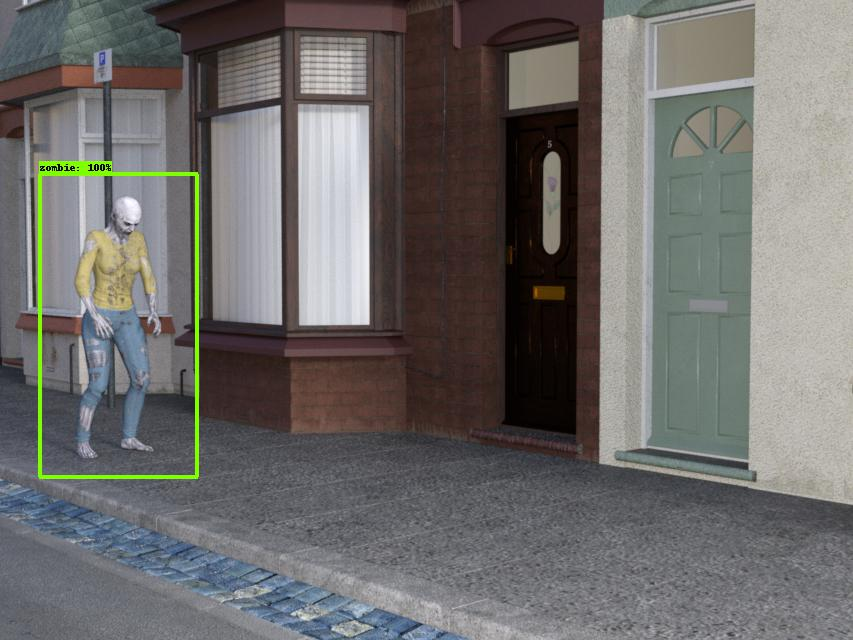


Frame 5


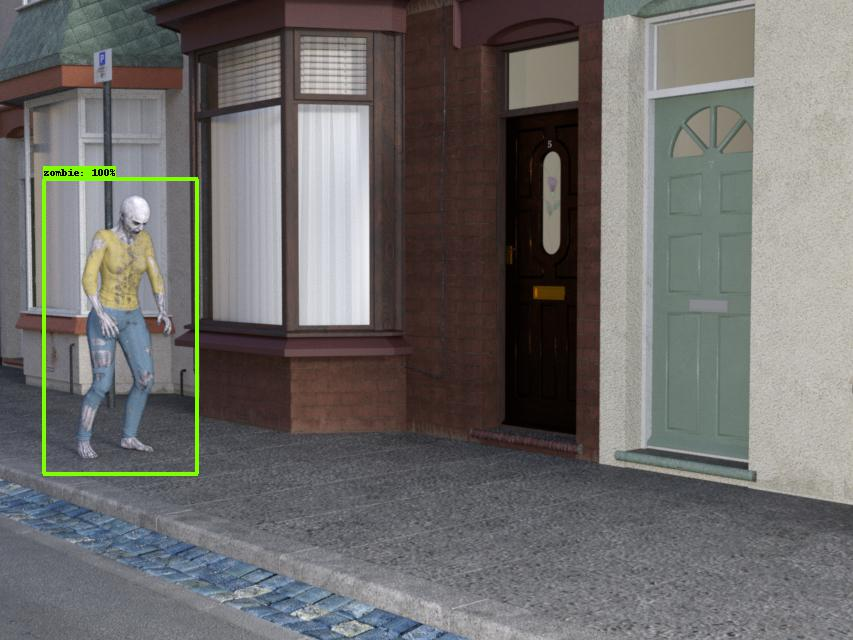


Frame 10


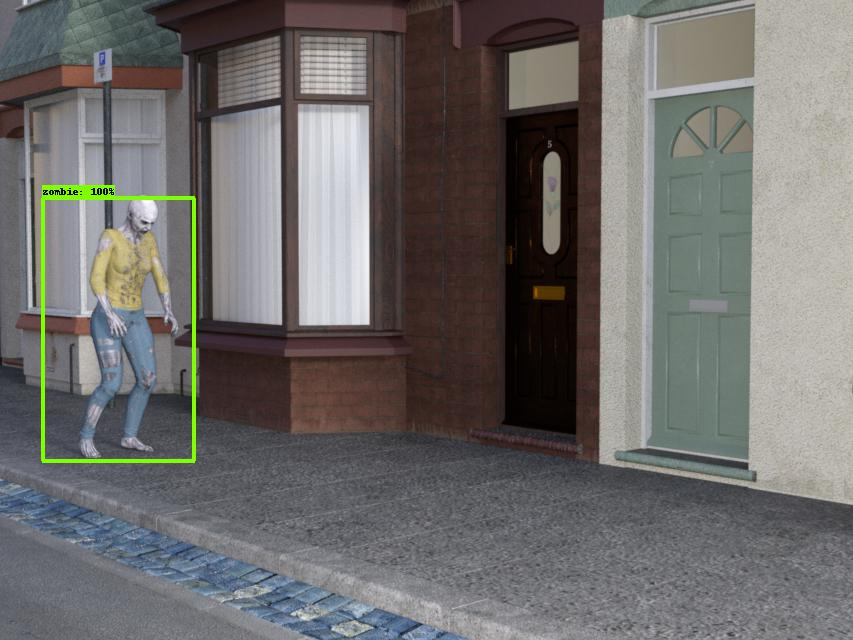

In [61]:
# display some still frames and inspect visually. If you don't see a bounding box around the zombie, please consider 
# re-annotating the ground truth or use the predefined gt_boxes

print('Frame 0')
display(IPyImage('./results/gif_frame_000.jpg'))
print()
print('Frame 5')
display(IPyImage('./results/gif_frame_005.jpg'))
print()
print('Frame 10')
display(IPyImage('./results/gif_frame_010.jpg'))

In [62]:
# create a zip of the zombie-walk images
zipf = zipfile.ZipFile('./zombie.zip', 'w', zipfile.ZIP_DEFLATED)

filenames = glob.glob('./results/gif_frame_*.jpg')
filenames = sorted(filenames)

for filename in filenames:
    zipf.write(filename)

zipf.close()

In [63]:
# create Zombie animation
imageio.plugins.freeimage.download()

!rm -rf ./results/zombie-anim.gif

anim_file = './zombie-anim.gif'

filenames = glob.glob('./results/gif_frame_*.jpg')
filenames = sorted(filenames)
last = -1
images = []

for filename in filenames:
    image = imageio.imread(filename)
    images.append(image)

imageio.mimsave(anim_file, images, 'GIF-FI', fps=10)

Imageio: 'libfreeimage-3.16.0-linux64.so' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/freeimage/libfreeimage-3.16.0-linux64.so (4.6 MB)
Downloading: 8192/4830080 bytes (0.2%)4830080/4830080 bytes (100.0%)
  Done
File saved as /root/.imageio/freeimage/libfreeimage-3.16.0-linux64.so.


In [64]:
# save a results file
import pickle

# remove file if it exists
!rm results.data

# write results to binary file. upload for grading.
with open('results.data', 'wb') as filehandle:
    pickle.dump(results['boxes'], filehandle)

print('Done saving! Please download `results.data` from the Files tab\n' \
      'on the left.\nYou can also use the next cell as a shortcut for downloading.')

rm: cannot remove 'results.data': No such file or directory
Done saving! Please download `results.data` from the Files tab
on the left.
You can also use the next cell as a shortcut for downloading.


In [65]:
from google.colab import files
files.download('results.data')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>